In [42]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [158]:
import scanpy as sc
import pandas as pd
import warnings

from utils import get_cell_cycle_genes, base_preprocess, run_annotation, save_pkl, load_pkl, plot_umaps
from validation import score, score_lt
from visualization import plot_jitter_boxplot, combine_metrics_data

In [15]:
warnings.simplefilter('ignore')

## GSE162500

In [7]:
adata = sc.read_h5ad('/home/amikhailichenko/training_scirpy/data/GSE162500_for_validation.h5ad')

In [8]:
cell_cycle_genes = get_cell_cycle_genes(adata, 'data/G2M_phase.txt', 'data/S_phase.txt')
cell_cycle_genes

['G2E3', 'E2F8']

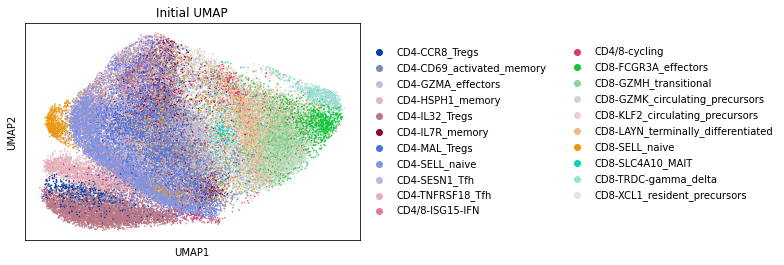

In [78]:
adata = base_preprocess(adata, batch_key='sample')

### Removed genes

In [79]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='sample', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='removed_genes',
    cell_cycle_genes=cell_cycle_genes,
)

In [69]:
save_pkl(adatas_corrected, 'data/result/GSE162500_annotation_with_removed_genes_1.pkl')

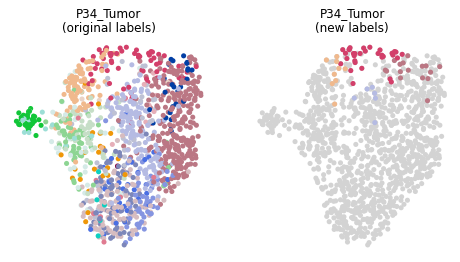

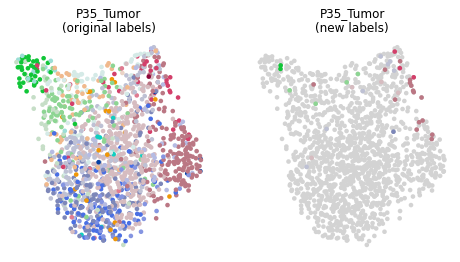

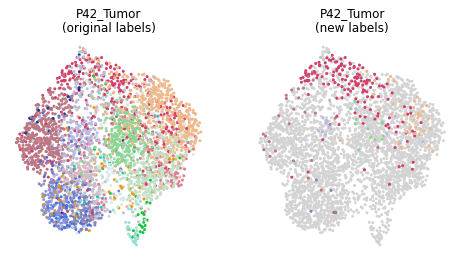

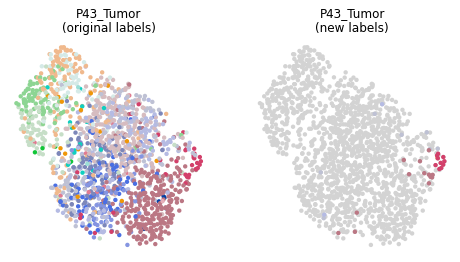

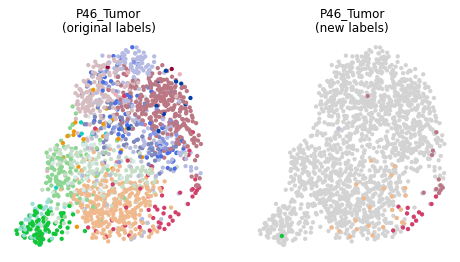

...

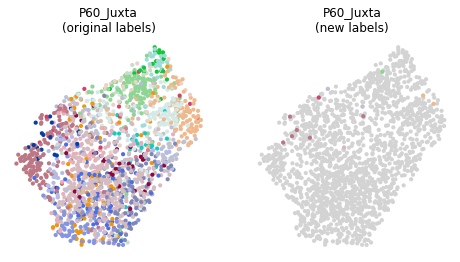

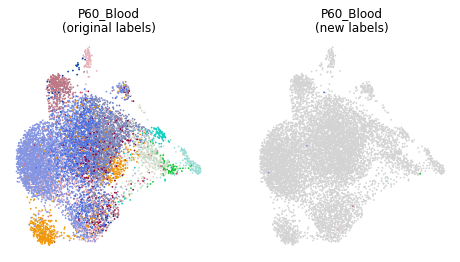

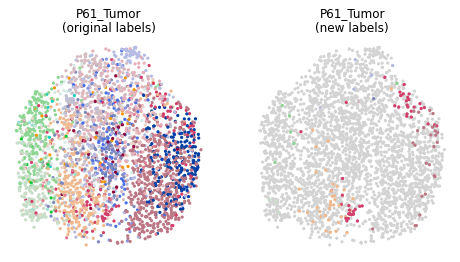

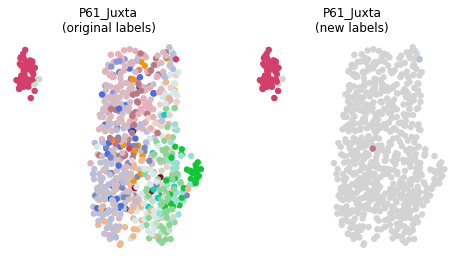

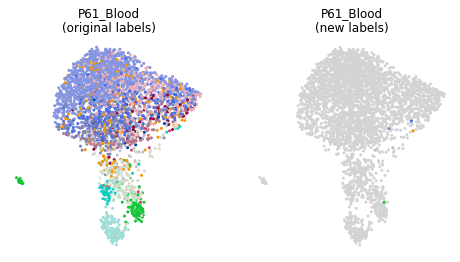

In [82]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

#### Scoring

In [86]:
cell_type_ver = pd.read_csv('data/real/GSE162500_cell_type_ver.csv')
cell_type_ver['argmax_pred'] = cell_type_ver.iloc[:, 4:].idxmax(axis=1)
cell_type_ver.head()

,Unnamed: 0,clone_id_size,clone_id,CD4/8-cycling,CD4-MAL_Tregs,CD8-XCL1_resident_precursors,CD4-IL7R_memory,CD8-LAYN_terminally_differentiated,CD4/8-ISG15-IFN,CD8-GZMH_transitional,...,CD4-IL32_Tregs,CD4-GZMA_effectors,CD8-GZMK_circulating_precursors,CD4-SESN1_Tfh,CD4-HSPH1_memory,CD4-CD69_activated_memory,CD8-SELL_naive,CD8-TRDC-gamma_delta,CD8-KLF2_circulating_precursors,argmax_pred
0,0,60.0,1486,2.0,0.0,0.0,0.0,0.982759,0.000000,0.0,...,0.0,0.000000,0.000000,0.017241,0.000000,0.000000,0.0,0.000000,0.000000,CD8-LAYN_terminally_differentiated
1,1,30.0,3046,1.0,0.0,0.0,0.0,0.000000,0.000000,0.0,...,0.0,0.000000,0.068966,0.000000,0.000000,0.000000,0.0,0.068966,0.379310,CD8-FCGR3A_effectors
2,2,28.0,18592,5.0,0.0,0.0,0.0,0.826087,0.043478,0.0,...,0.0,0.043478,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.086957,CD8-LAYN_terminally_differentiated
3,3,17.0,6519,6.0,0.0,0.0,0.0,0.909091,0.090909,0.0,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,CD8-LAYN_terminally_differentiated
4,4,14.0,18648,3.0,0.0,0.0,0.0,0.000000,0.000000,0.0,...,0.0,0.636364,0.000000,0.000000,0.272727,0.090909,0.0,0.000000,0.000000,CD4-GZMA_effectors


In [91]:
gse162500_drop_genes_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch P34_Tumor are nans
all clone_ids at batch P35_Tumor are nans
all clone_ids at batch P42_Tumor are nans
all clone_ids at batch P43_Tumor are nans
all clone_ids at batch P46_Tumor are nans
F1 weighted score for batch P47_Tumor = 0.32
F1 macro score for batch P47_Tumor = 0.13333333333333333
-------------------------
F1 weighted score for batch P55_Tumor = 1.0
F1 macro score for batch P55_Tumor = 1.0
-------------------------
F1 weighted score for batch P57_Tumor = 1.0
F1 macro score for batch P57_Tumor = 1.0
-------------------------
all clone_ids at batch P57_Blood are nans
F1 weighted score for batch P58_Tumor = 1.0
F1 macro score for batch P58_Tumor = 1.0
-------------------------
F1 weighted score for batch P58_Blood = 1.0
F1 macro score for batch P58_Blood = 1.0
-------------------------
F1 weighted score for batch P60_Tumor = 0.5960065774019263
F1 macro score for batch P60_Tumor = 0.2785529715762274
-------------------------
clone_ids intersection at batch P60

### Cell-Cycle Scoring

In [98]:
cell_cycle_genes_both = get_cell_cycle_genes(
    adata, 
    'data/G2M_phase.txt', 
    'data/S_phase.txt', 
    return_both=True,
)

In [99]:
sc.tl.score_genes_cell_cycle(adata, s_genes=cell_cycle_genes_both[0], g2m_genes=cell_cycle_genes_both[1])

In [102]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='sample', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='cc_scoring',
)

In [104]:
save_pkl(adatas_corrected, 'data/result/GSE162500_cell_cycle_scoring_1.pkl')

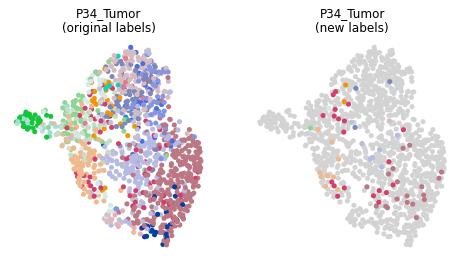

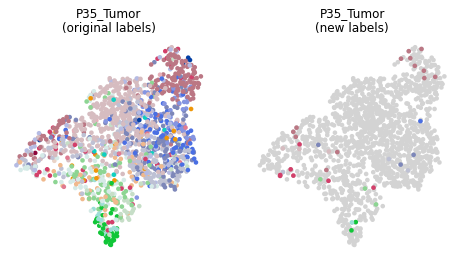

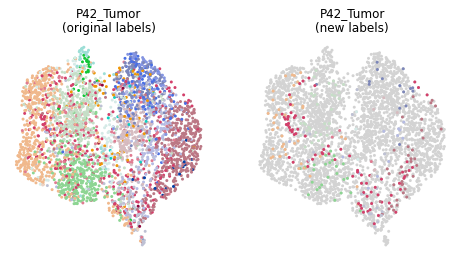

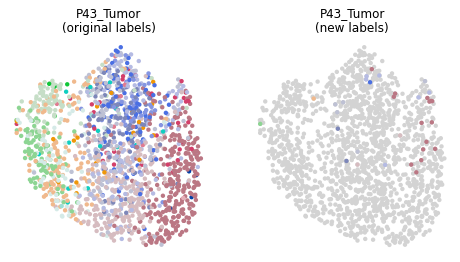

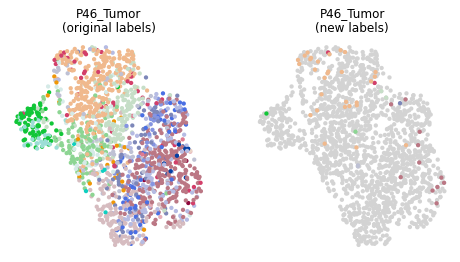

...

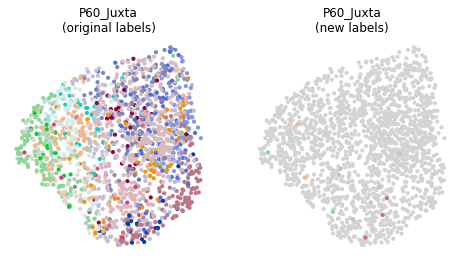

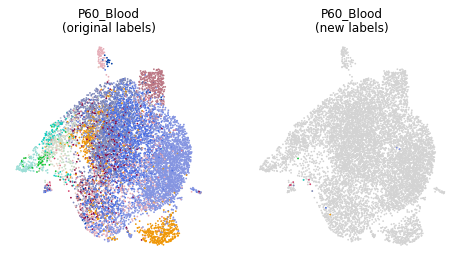

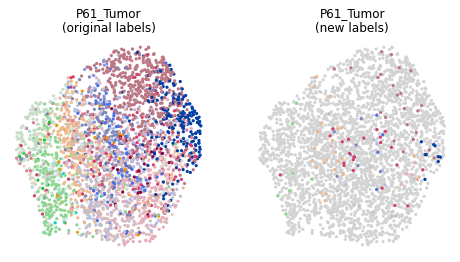

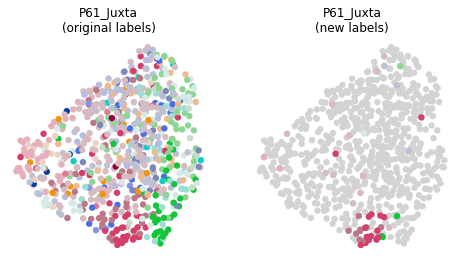

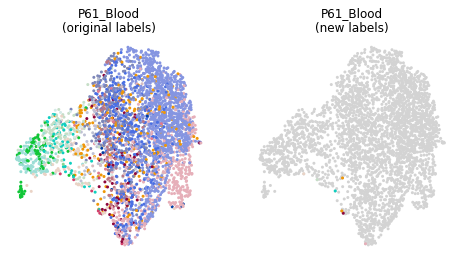

In [105]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

#### Scoring

In [109]:
gse162500_cc_scoring_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch P34_Tumor are nans
all clone_ids at batch P35_Tumor are nans
all clone_ids at batch P42_Tumor are nans
all clone_ids at batch P43_Tumor are nans
all clone_ids at batch P46_Tumor are nans
F1 weighted score for batch P47_Tumor = 0.32
F1 macro score for batch P47_Tumor = 0.08
-------------------------
F1 weighted score for batch P55_Tumor = 0.8000000000000002
F1 macro score for batch P55_Tumor = 0.26666666666666666
-------------------------
F1 weighted score for batch P57_Tumor = 1.0
F1 macro score for batch P57_Tumor = 1.0
-------------------------
all clone_ids at batch P57_Blood are nans
F1 weighted score for batch P58_Tumor = 1.0
F1 macro score for batch P58_Tumor = 1.0
-------------------------
F1 weighted score for batch P58_Blood = 1.0
F1 macro score for batch P58_Blood = 1.0
-------------------------
F1 weighted score for batch P60_Tumor = 0.4450899977215766
F1 macro score for batch P60_Tumor = 0.10870927318295738
-------------------------
clone_ids intersec

### Label Transfer

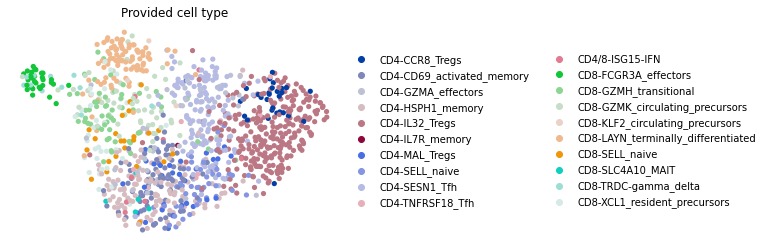

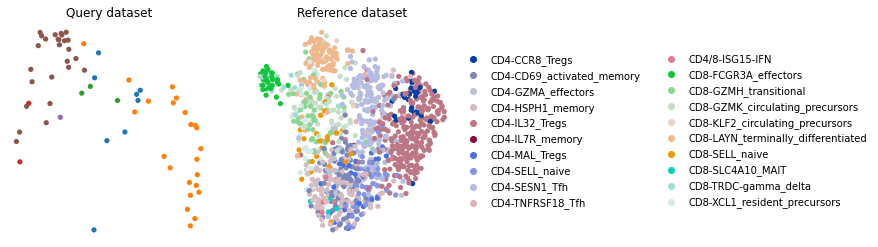

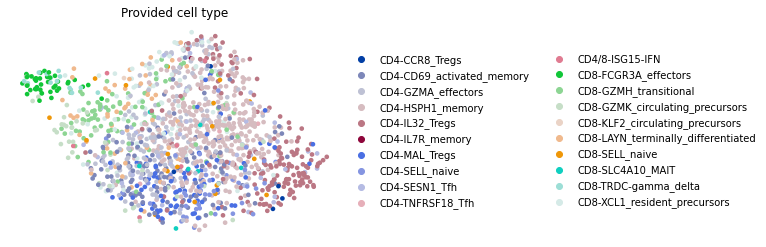

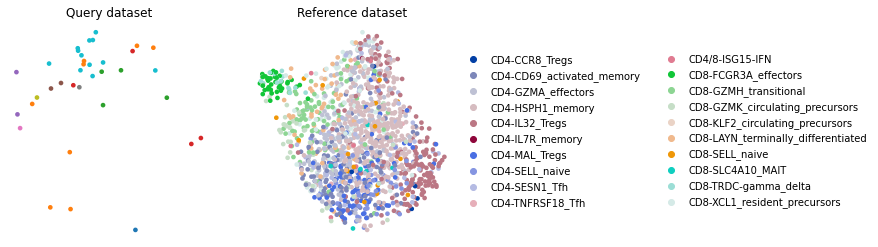

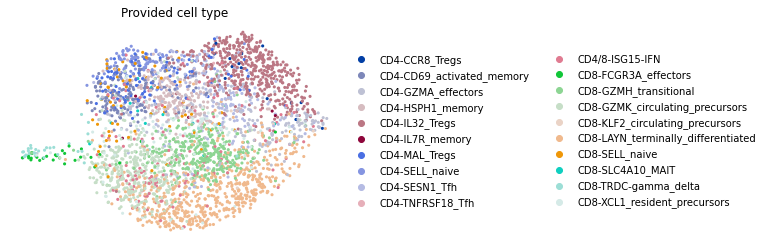

...

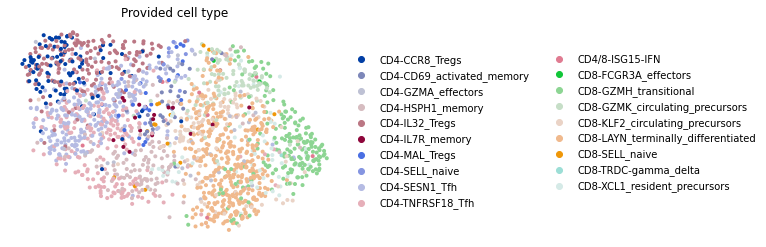

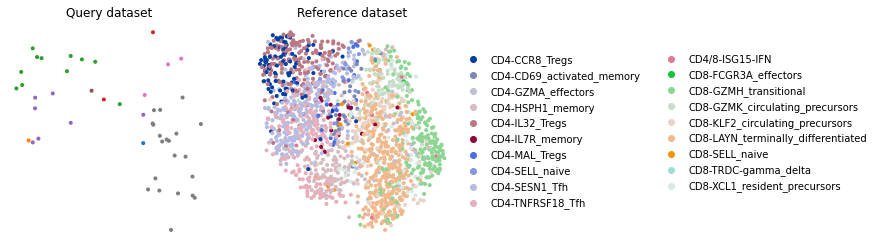

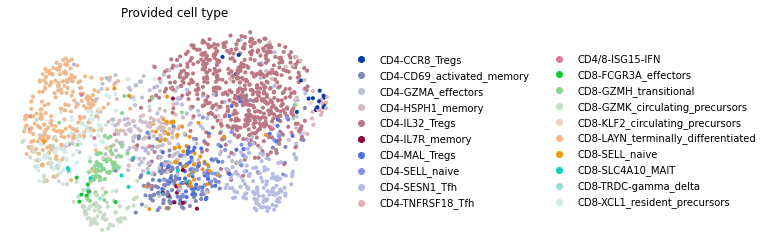

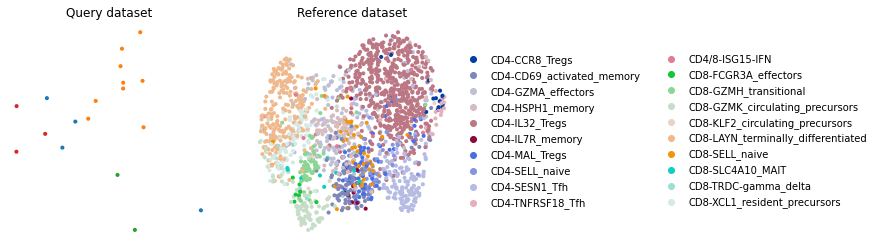

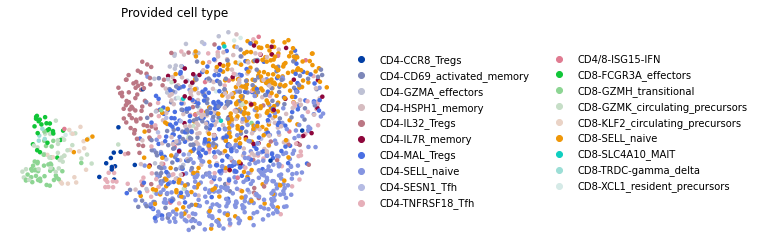

error for batch P57_Blood


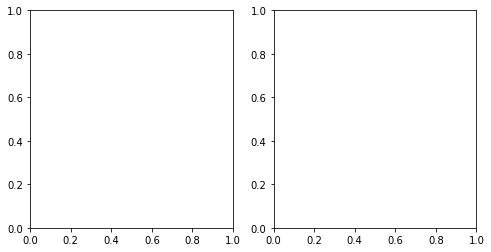

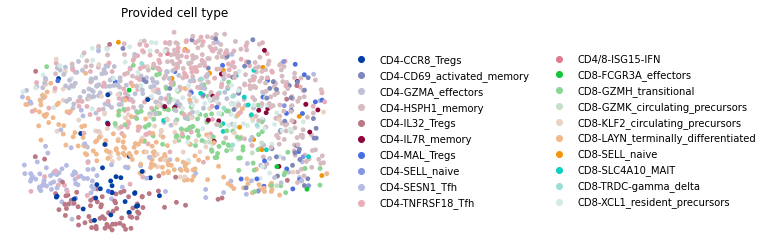

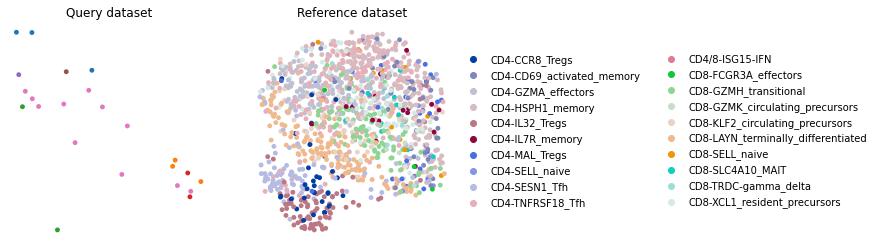

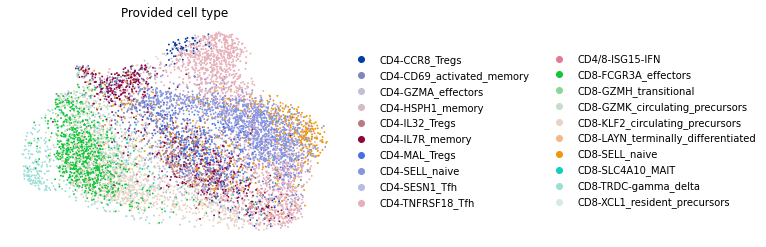

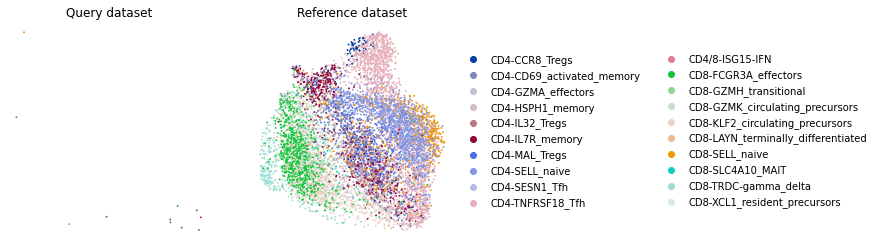

...

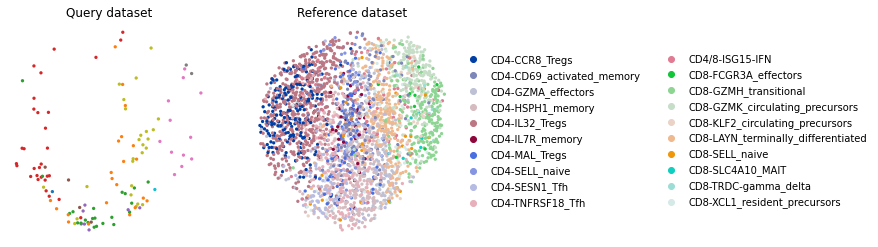

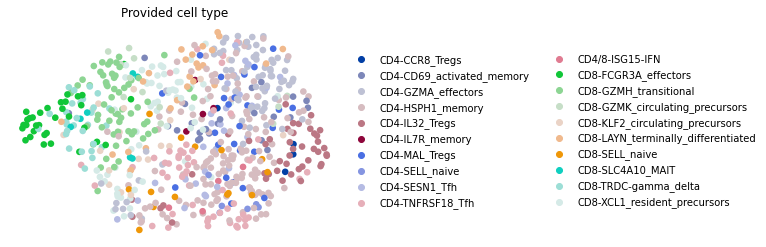

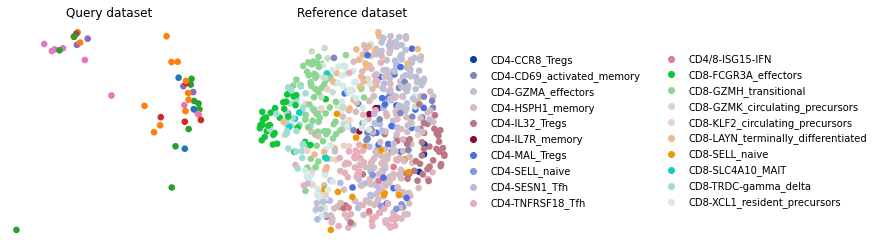

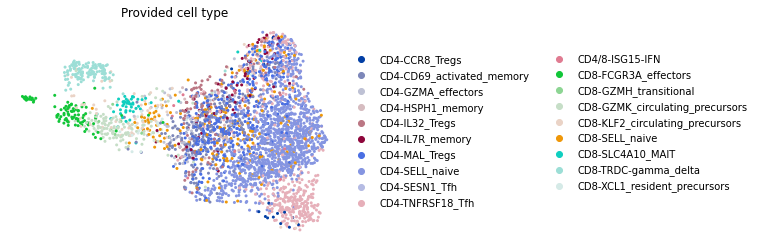

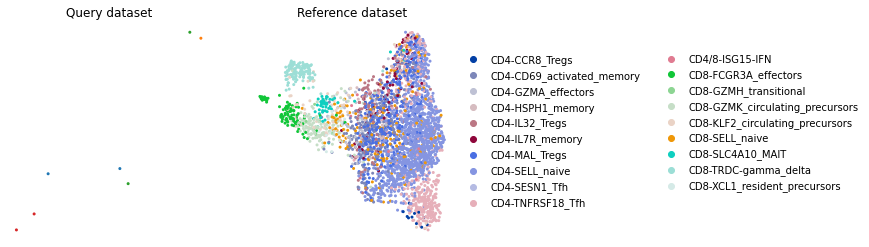

In [124]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='sample', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='label_transfer',
)

In [125]:
save_pkl(adatas_corrected, 'data/result/GSE162500_adatas_query_labels_1.pkl')

#### Scoring

In [127]:
gse162500_label_transfer_metrics = score_lt(adatas_corrected, cell_type_ver)

all clone_ids at batch P34_Tumor are nans
all clone_ids at batch P35_Tumor are nans
all clone_ids at batch P42_Tumor are nans
all clone_ids at batch P43_Tumor are nans
all clone_ids at batch P46_Tumor are nans
F1 weighted score for batch P47_Tumor = 0.6
F1 macro score for batch P47_Tumor = 0.25
-------------------------
F1 weighted score for batch P55_Tumor = 0.9565217391304349
F1 macro score for batch P55_Tumor = 0.4782608695652174
-------------------------
F1 weighted score for batch P57_Tumor = 1.0
F1 macro score for batch P57_Tumor = 1.0
-------------------------
F1 weighted score for batch P58_Tumor = 1.0
F1 macro score for batch P58_Tumor = 1.0
-------------------------
F1 weighted score for batch P58_Blood = 1.0
F1 macro score for batch P58_Blood = 1.0
-------------------------
F1 weighted score for batch P60_Tumor = 0.9352280261371171
F1 macro score for batch P60_Tumor = 0.4232284232284232
-------------------------
clone_ids intersection at batch P60_Juxta is empty
F1 weighted 

### Vanilla classification

In [128]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='sample', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='vanilla',
)

In [129]:
save_pkl(adatas_corrected, 'data/result/GSE162500_vanilla_clf_1.pkl')

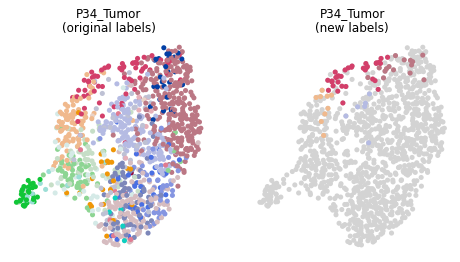

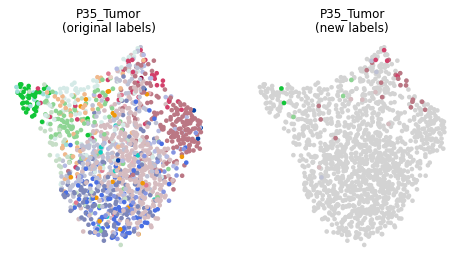

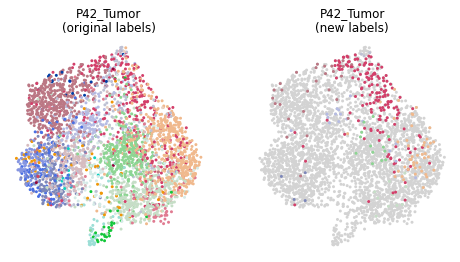

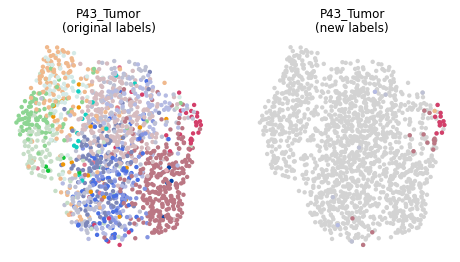

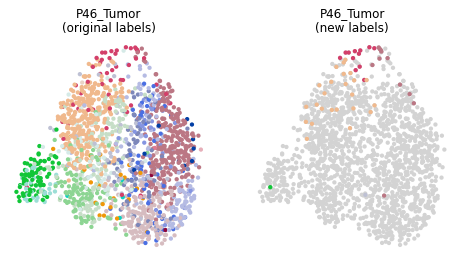

...

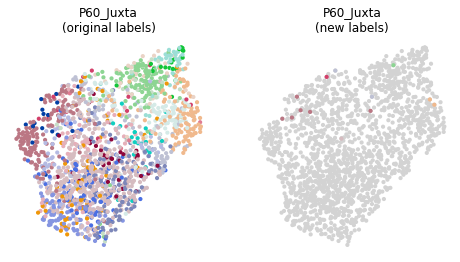

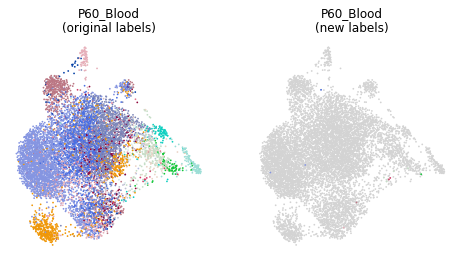

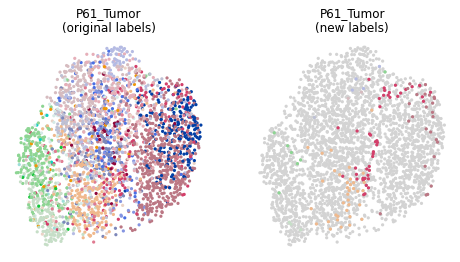

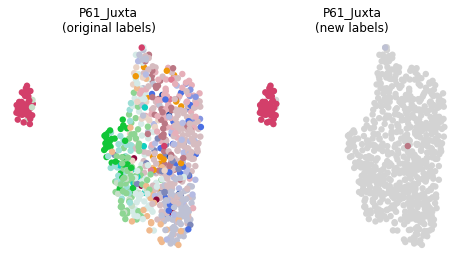

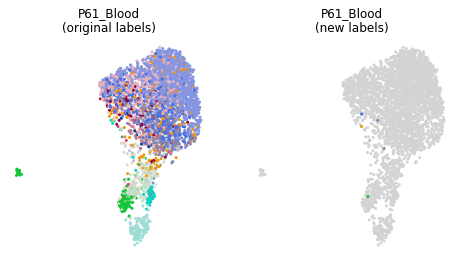

In [130]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

#### Scoring

In [131]:
gse162500_vanilla_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch P34_Tumor are nans
all clone_ids at batch P35_Tumor are nans
all clone_ids at batch P42_Tumor are nans
all clone_ids at batch P43_Tumor are nans
all clone_ids at batch P46_Tumor are nans
F1 weighted score for batch P47_Tumor = 0.32
F1 macro score for batch P47_Tumor = 0.13333333333333333
-------------------------
F1 weighted score for batch P55_Tumor = 1.0
F1 macro score for batch P55_Tumor = 1.0
-------------------------
F1 weighted score for batch P57_Tumor = 1.0
F1 macro score for batch P57_Tumor = 1.0
-------------------------
all clone_ids at batch P57_Blood are nans
F1 weighted score for batch P58_Tumor = 1.0
F1 macro score for batch P58_Tumor = 1.0
-------------------------
F1 weighted score for batch P58_Blood = 1.0
F1 macro score for batch P58_Blood = 1.0
-------------------------
F1 weighted score for batch P60_Tumor = 0.5960065774019263
F1 macro score for batch P60_Tumor = 0.2785529715762274
-------------------------
clone_ids intersection at batch P60

## GSE154826

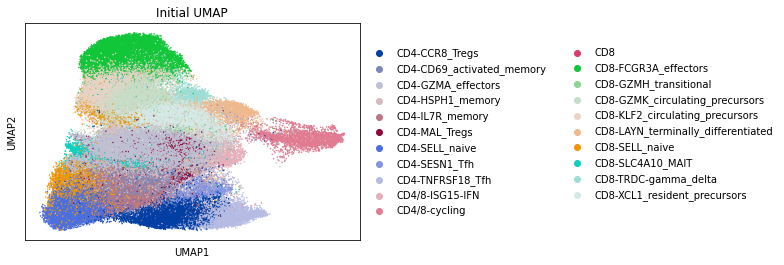

In [132]:
adata = sc.read_h5ad('/home/amikhailichenko/GSE154826/data/GSE154826_for_validation.h5ad')
adata = base_preprocess(adata, batch_key='amp_batch_ID')

### Removed genes

In [ ]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='amp_batch_ID', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='removed_genes',
    cell_cycle_genes=cell_cycle_genes,
    n_pcs=15,
    n_neighbors=10,
)

In [141]:
save_pkl(adatas_corrected, 'data/result/GSE154826_annotation_with_removed_genes_1.pkl')

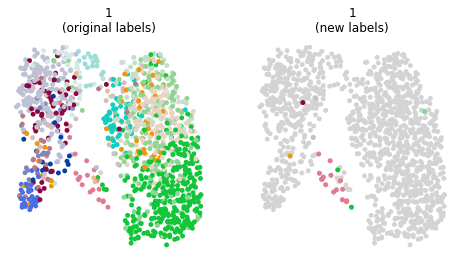

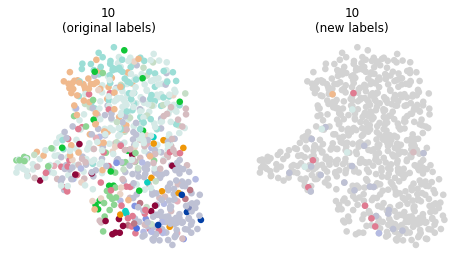

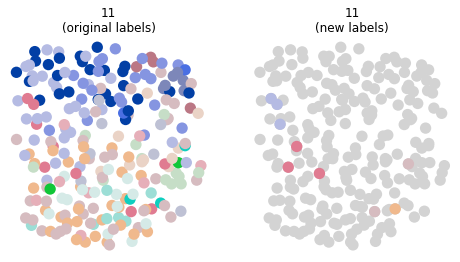

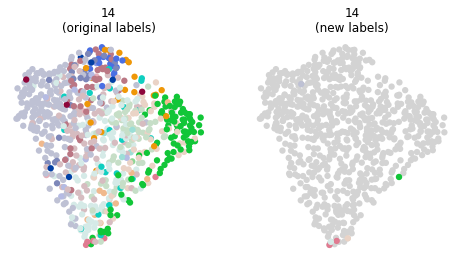

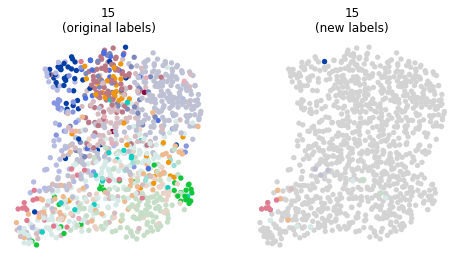

...

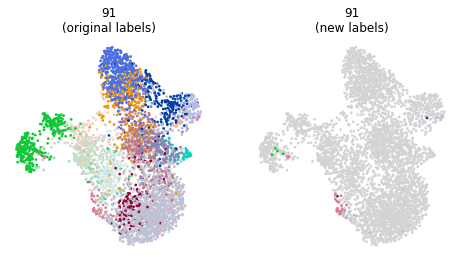

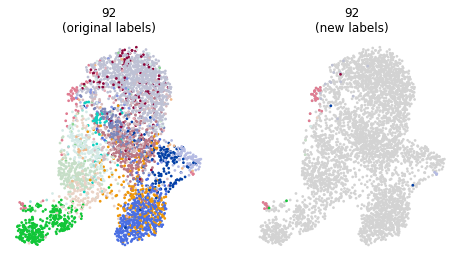

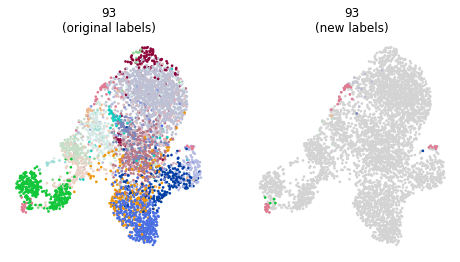

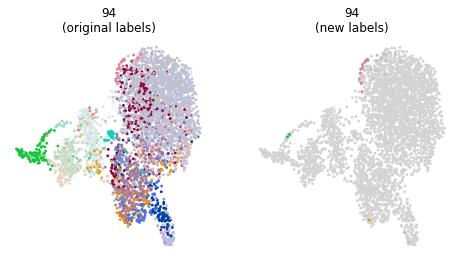

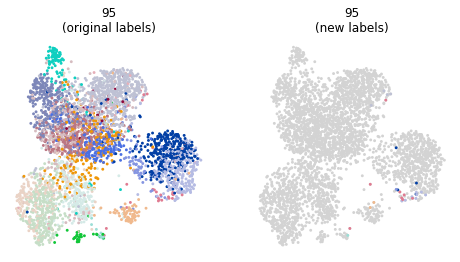

In [142]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

In [145]:
cell_type_ver = pd.read_csv('data/real/GSE154826_cell_type_ver.csv')
cell_type_ver['argmax_pred'] = cell_type_ver.iloc[:, 4:].idxmax(axis=1)

#### Scoring

In [146]:
gse154826_drop_genes_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch 1 are nans
all clone_ids at batch 10 are nans
all clone_ids at batch 11 are nans
all clone_ids at batch 14 are nans
all clone_ids at batch 15 are nans
all clone_ids at batch 16 are nans
all clone_ids at batch 17 are nans
all clone_ids at batch 18 are nans
all clone_ids at batch 19 are nans
all clone_ids at batch 2 are nans
all clone_ids at batch 23 are nans
all clone_ids at batch 230 are nans
all clone_ids at batch 231 are nans
all clone_ids at batch 24 are nans
F1 weighted score for batch 244 = 0.3333333333333333
F1 macro score for batch 244 = 0.25
-------------------------
F1 weighted score for batch 245 = 0.226
F1 macro score for batch 245 = 0.17500000000000002
-------------------------
all clone_ids at batch 25 are nans
all clone_ids at batch 27 are nans
all clone_ids at batch 28 are nans
all clone_ids at batch 29 are nans
all clone_ids at batch 292 are nans
all clone_ids at batch 293 are nans
all clone_ids at batch 3 are nans
all clone_ids at batch 30 are na

### Cell-Cycle Scoring

In [147]:
cell_cycle_genes_both = get_cell_cycle_genes(
    adata, 
    'data/G2M_phase.txt', 
    'data/S_phase.txt', 
    return_both=True,
)

In [148]:
sc.tl.score_genes_cell_cycle(adata, s_genes=cell_cycle_genes_both[0], g2m_genes=cell_cycle_genes_both[1])

In [ ]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='amp_batch_ID', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='cc_scoring',
    n_pcs=15,
    n_neighbors=10,
)

In [151]:
save_pkl(adatas_corrected, 'data/result/GSE154826_cell_cycle_scoring_1.pkl')

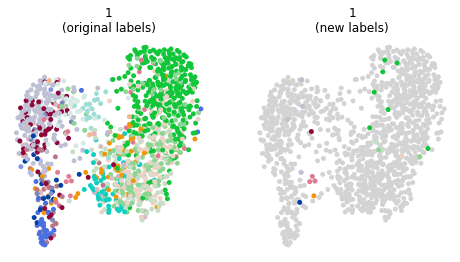

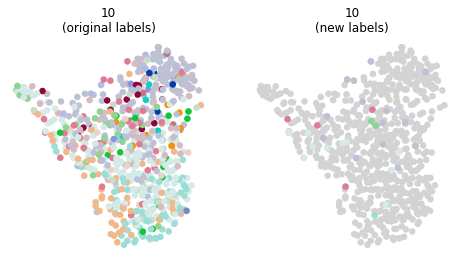

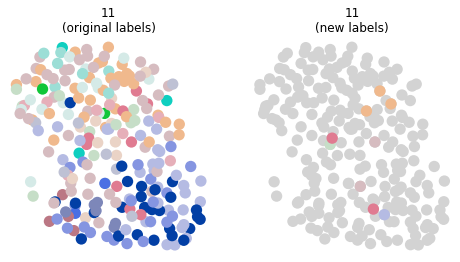

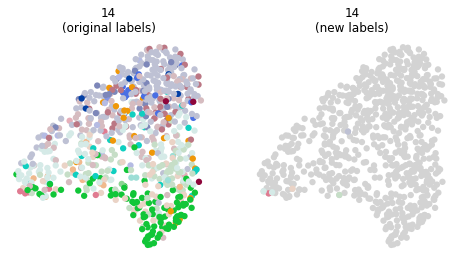

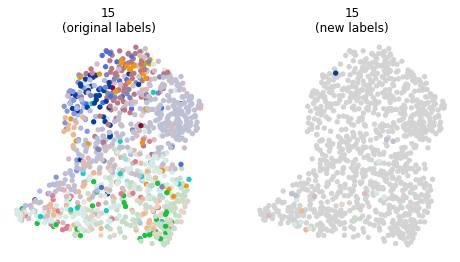

...

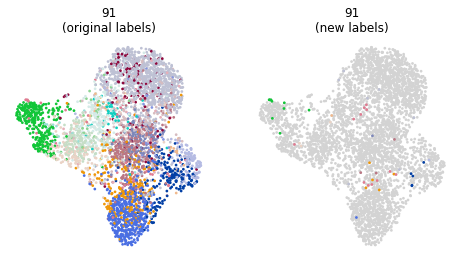

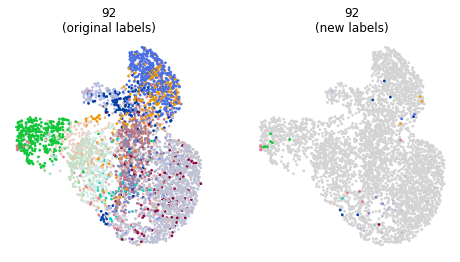

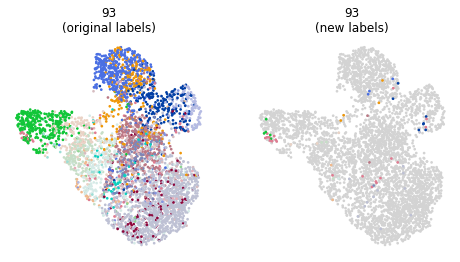

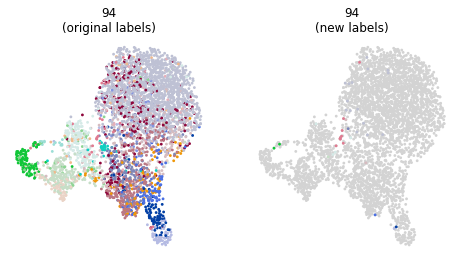

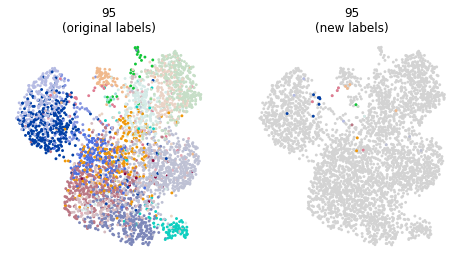

In [152]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

#### Scoring

In [153]:
gse154826_cc_scoring_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch 1 are nans
all clone_ids at batch 10 are nans
all clone_ids at batch 11 are nans
all clone_ids at batch 14 are nans
all clone_ids at batch 15 are nans
all clone_ids at batch 16 are nans
all clone_ids at batch 17 are nans
all clone_ids at batch 18 are nans
all clone_ids at batch 19 are nans
all clone_ids at batch 2 are nans
all clone_ids at batch 23 are nans
all clone_ids at batch 230 are nans
all clone_ids at batch 231 are nans
all clone_ids at batch 24 are nans
F1 weighted score for batch 244 = 0.3333333333333333
F1 macro score for batch 244 = 0.25
-------------------------
F1 weighted score for batch 245 = 0.22666666666666666
F1 macro score for batch 245 = 0.23809523809523808
-------------------------
all clone_ids at batch 25 are nans
all clone_ids at batch 27 are nans
all clone_ids at batch 28 are nans
all clone_ids at batch 29 are nans
all clone_ids at batch 292 are nans
all clone_ids at batch 293 are nans
all clone_ids at batch 3 are nans
all clone_ids at b

### Label Transfer

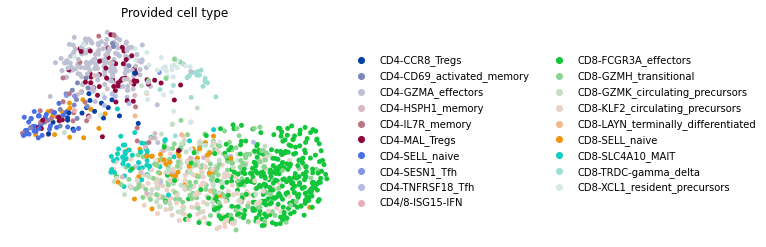

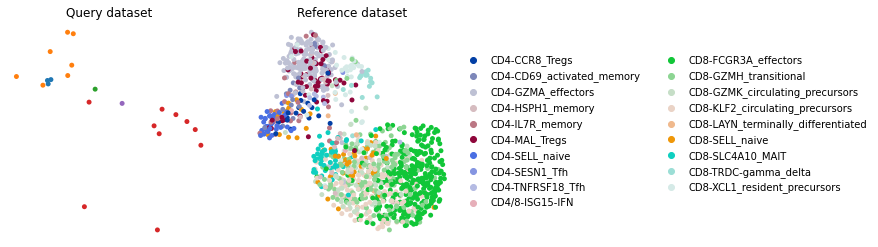

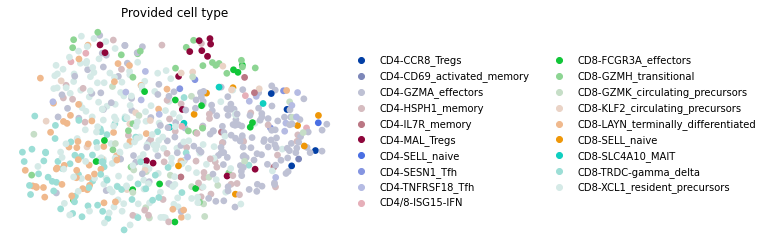

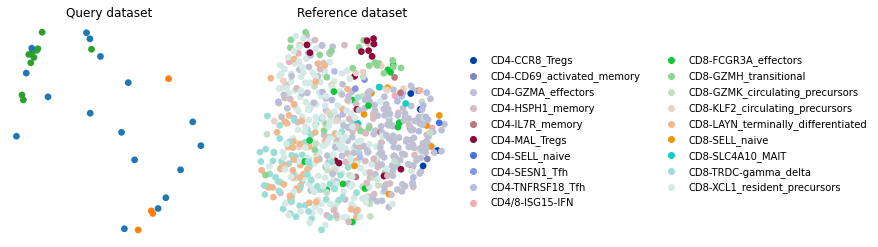

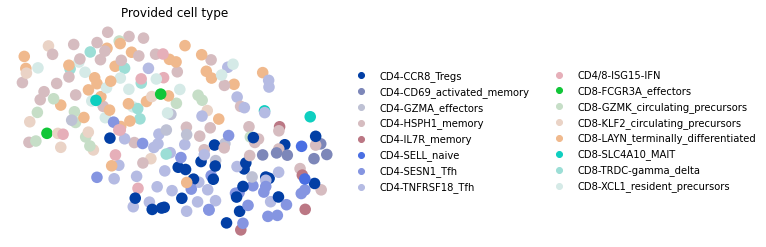

...

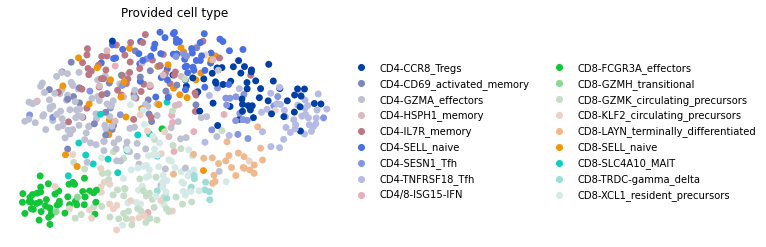

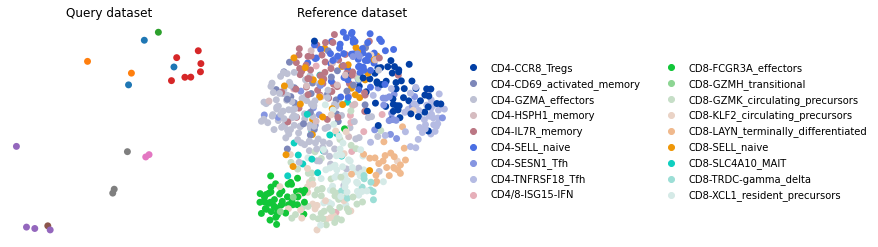

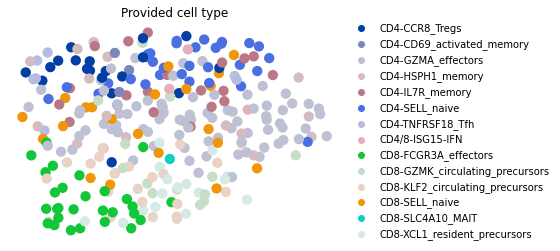

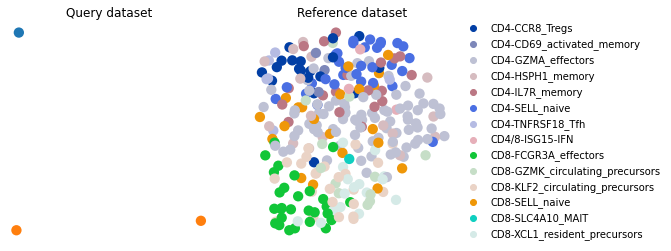

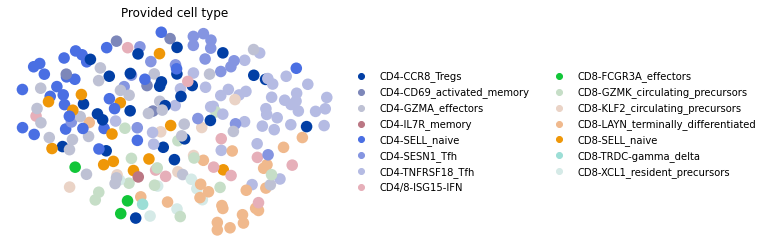

error for batch 231


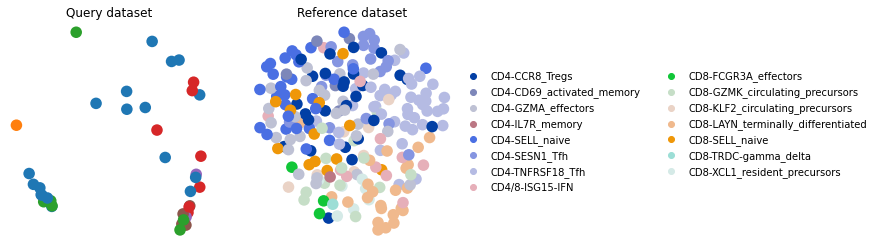

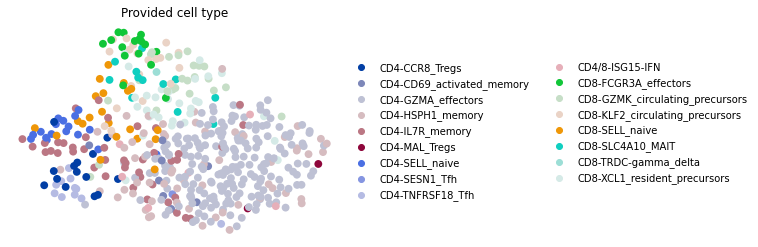

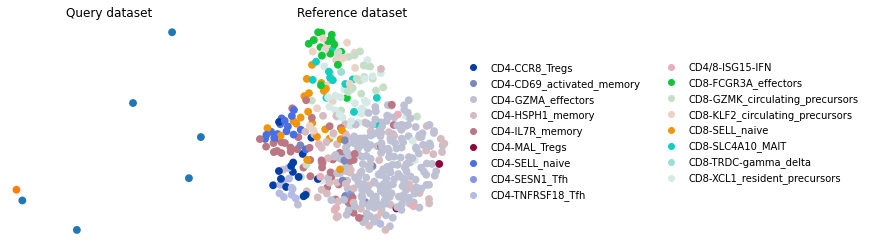

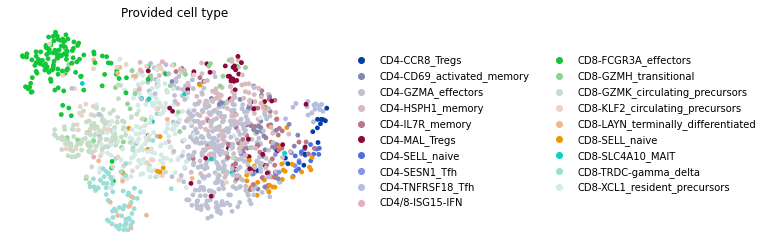

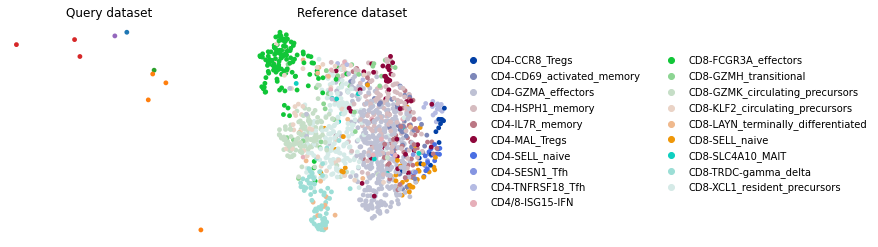

...

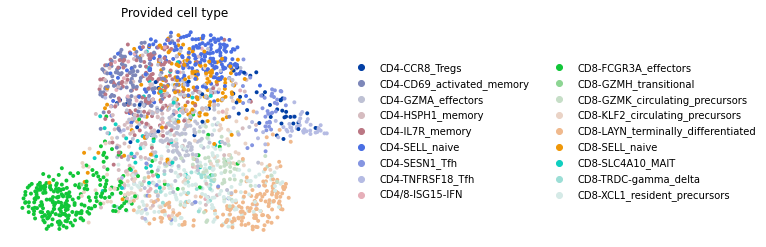

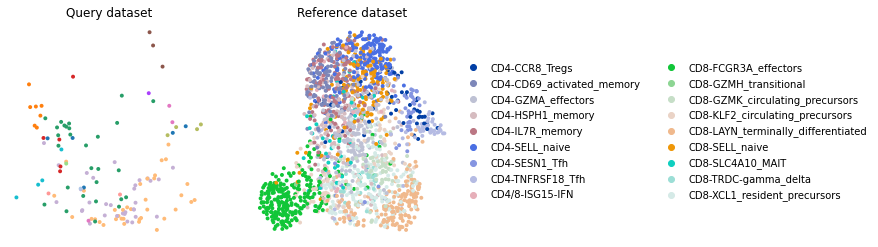

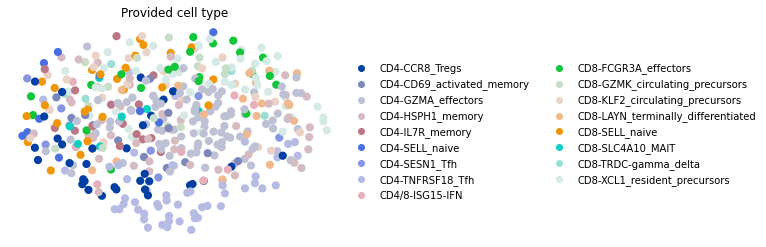

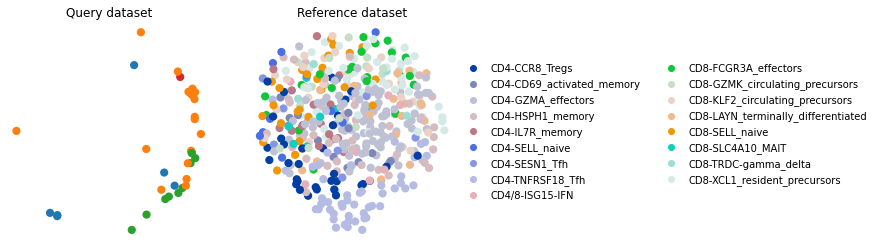

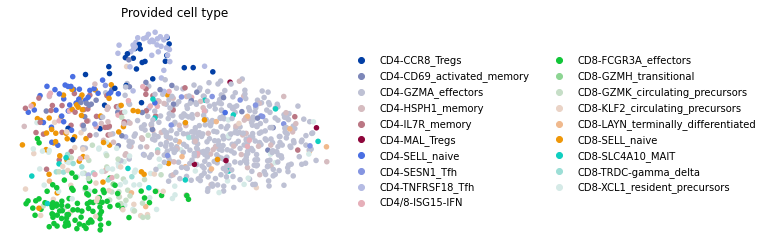

error for batch 5


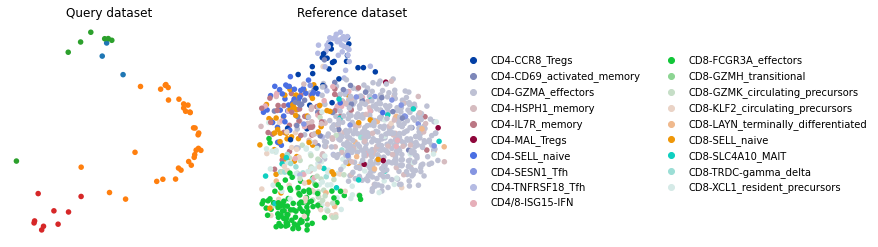

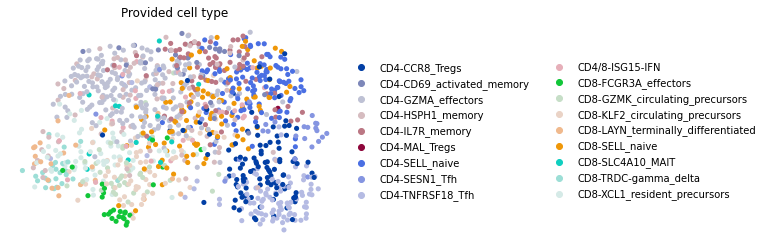

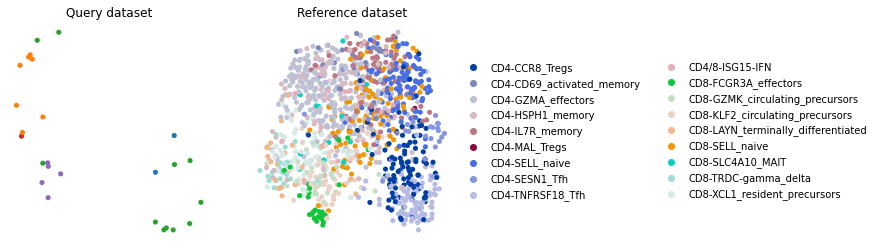

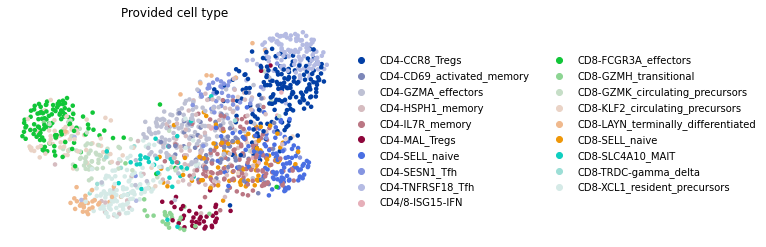

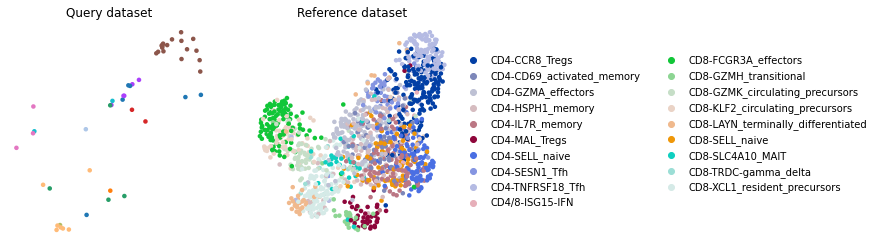

...

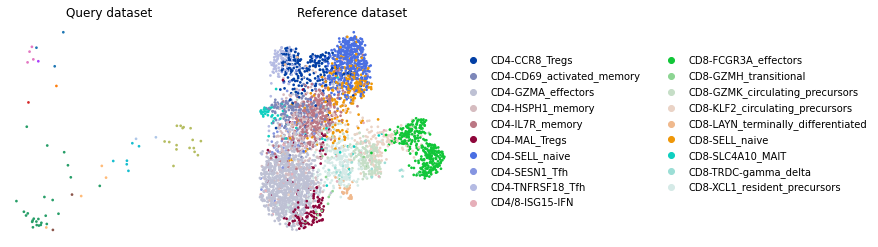

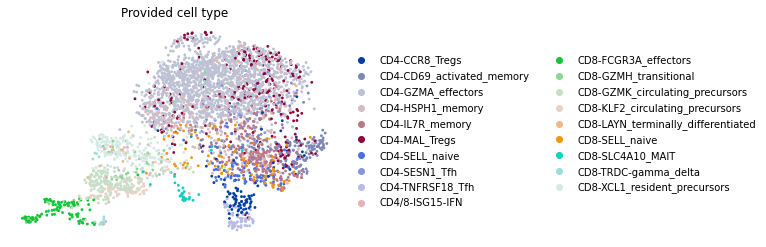

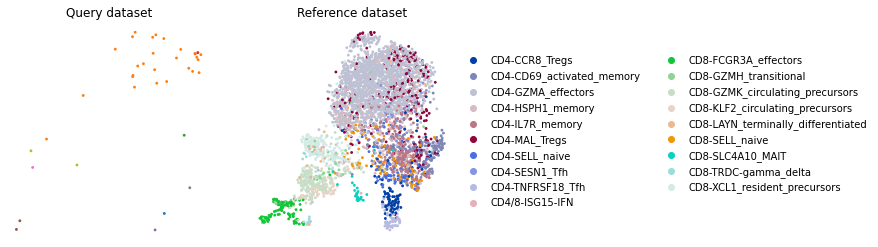

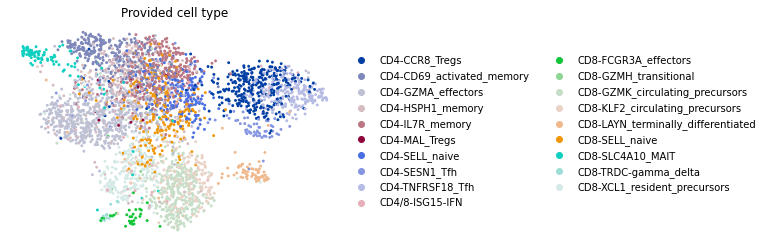

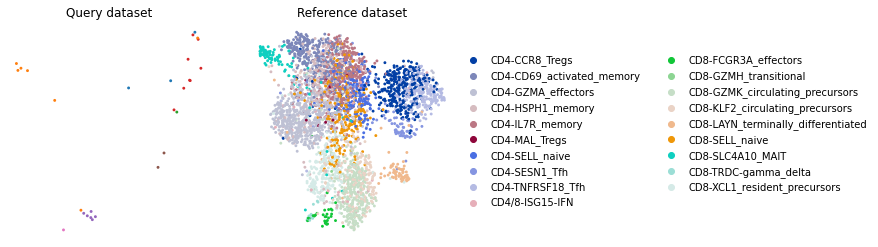

In [154]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='amp_batch_ID', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='label_transfer',
)

In [155]:
save_pkl(adatas_corrected, 'data/result/GSE154826_adatas_query_labels_1.pkl')

#### Scoring

In [156]:
gse154826_label_transfer_metrics = score_lt(adatas_corrected, cell_type_ver)

all clone_ids at batch 1 are nans
all clone_ids at batch 10 are nans
all clone_ids at batch 11 are nans
all clone_ids at batch 14 are nans
all clone_ids at batch 15 are nans
all clone_ids at batch 16 are nans
all clone_ids at batch 17 are nans
all clone_ids at batch 18 are nans
all clone_ids at batch 19 are nans
all clone_ids at batch 2 are nans
all clone_ids at batch 23 are nans
all clone_ids at batch 230 are nans
all clone_ids at batch 24 are nans
F1 weighted score for batch 244 = 0.3333333333333333
F1 macro score for batch 244 = 0.25
-------------------------
F1 weighted score for batch 245 = 0.6498755980861245
F1 macro score for batch 245 = 0.3863294600136705
-------------------------
all clone_ids at batch 25 are nans
all clone_ids at batch 27 are nans
all clone_ids at batch 28 are nans
all clone_ids at batch 29 are nans
all clone_ids at batch 292 are nans
all clone_ids at batch 293 are nans
all clone_ids at batch 3 are nans
all clone_ids at batch 30 are nans
all clone_ids at batc

### Vanilla classification

In [ ]:
adatas_corrected = run_annotation(
    adata, 
    batch_name='amp_batch_ID', 
    obs_key='cell_type', 
    target_group='CD4/8-cycling', 
    layer='raw', 
    annotation_type='vanilla',
    n_pcs=15,
    n_neighbors=10,
)

In [162]:
save_pkl(adatas_corrected, 'data/result/GSE154826_vanilla_clf_1.pkl')

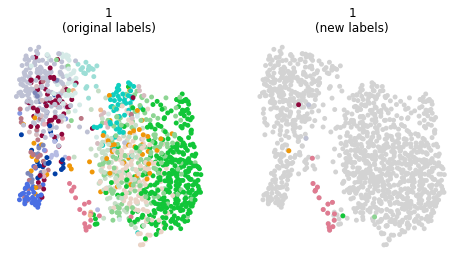

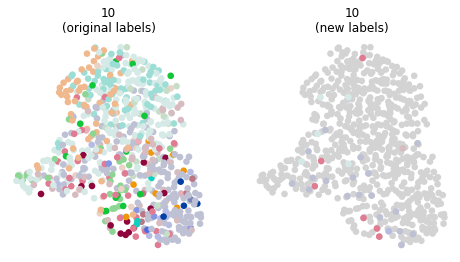

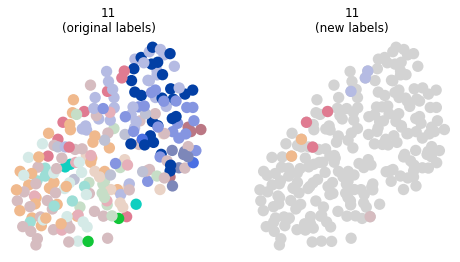

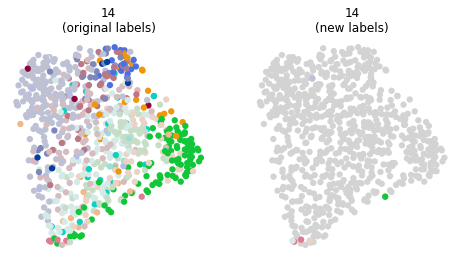

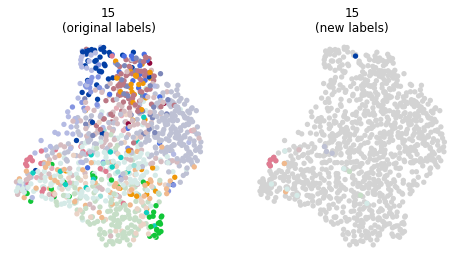

...

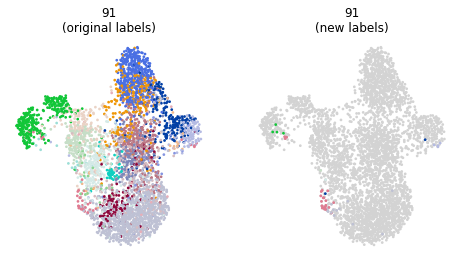

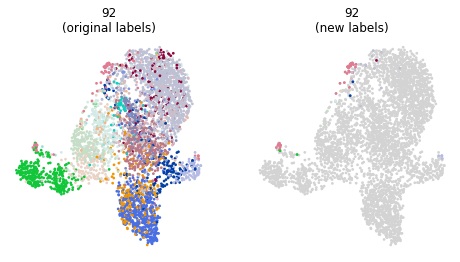

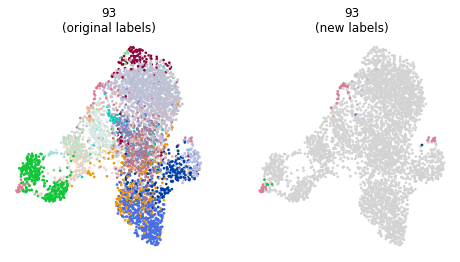

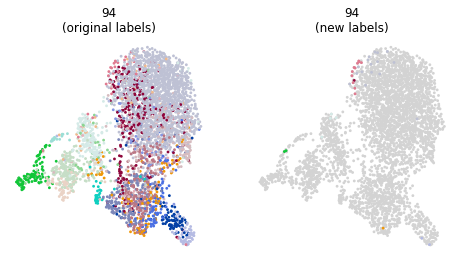

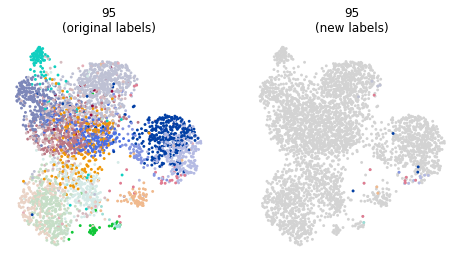

In [163]:
plot_umaps(adatas_corrected, obs_key='cell_type', target='CD4/8-cycling')

#### Scoring

In [164]:
gse154826_vanilla_metrics = score(adatas_corrected, cell_type_ver)

all clone_ids at batch 1 are nans
all clone_ids at batch 10 are nans
all clone_ids at batch 11 are nans
all clone_ids at batch 14 are nans
all clone_ids at batch 15 are nans
all clone_ids at batch 16 are nans
all clone_ids at batch 17 are nans
all clone_ids at batch 18 are nans
all clone_ids at batch 19 are nans
all clone_ids at batch 2 are nans
all clone_ids at batch 23 are nans
all clone_ids at batch 230 are nans
all clone_ids at batch 231 are nans
all clone_ids at batch 24 are nans
F1 weighted score for batch 244 = 0.3333333333333333
F1 macro score for batch 244 = 0.25
-------------------------
F1 weighted score for batch 245 = 0.226
F1 macro score for batch 245 = 0.15
-------------------------
all clone_ids at batch 25 are nans
all clone_ids at batch 27 are nans
all clone_ids at batch 28 are nans
all clone_ids at batch 29 are nans
all clone_ids at batch 292 are nans
all clone_ids at batch 293 are nans
all clone_ids at batch 3 are nans
all clone_ids at batch 30 are nans
all clone_id

## Combine metrics & plot

In [165]:
res_1 = combine_metrics_data('GSE162500', [gse162500_vanilla_metrics, gse162500_drop_genes_metrics, gse162500_cc_scoring_metrics, gse162500_label_transfer_metrics])
res_2 = combine_metrics_data('GSE154826', [gse154826_vanilla_metrics, gse154826_drop_genes_metrics, gse154826_cc_scoring_metrics, gse154826_label_transfer_metrics])
all_data = pd.concat([res_1, res_2])

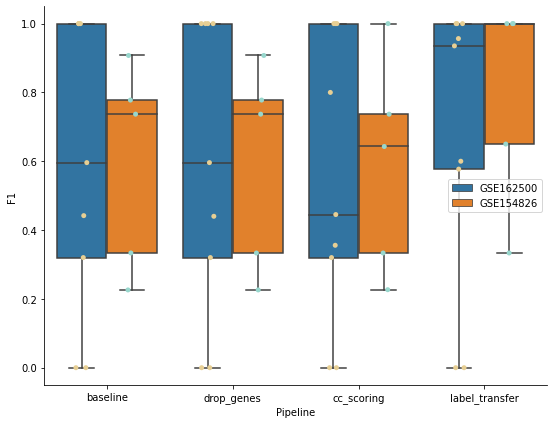

In [166]:
plot_jitter_boxplot(all_data)